In [31]:
import yfinance as yf
import pandas as pd
import warnings
import numpy as np
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objects as go
import cufflinks
import matplotlib.pyplot as plt

from scipy.stats import boxcox

from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.stattools import adfuller

import seaborn as sns
import hvplot
sns.set()

from itertools import product
from tqdm import tqdm_notebook

# Метрики для оценки качества работы алгоритмов для прогнозов временных рядов:
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

cufflinks.go_offline(connected=True)
init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")
%matplotlib inline

In [186]:
df = pd.read_csv('data.csv', parse_dates=True, index_col='dt')
df.head()

,MW
dt,
2011-01-01 00:00:00,3416.0
2011-01-01 00:15:00,4755.0
2011-01-01 00:30:00,4939.0
2011-01-01 00:45:00,4939.0
2011-01-01 01:00:00,4998.0


In [187]:
df.describe()

,MW
count,385566.000000
mean,3183.560481
std,3045.941591
min,0.000000
25%,905.000000
50%,2164.000000
75%,4529.877500
max,16727.500000


In [188]:
df.iplot()

Видим по графику, что данные очень разбросанные, наблюдается высокая дисперсия. Плюс очень много наблюдений. Поэтому для начала сгруппируем датасет по дням и добавим сглаживание скользящей средней в 30 наблюдений.

In [189]:
df_days = df.resample('D').sum()
df_days['MW_30'] = df_days.MW.rolling(30, center=True).mean()
df_days.iplot()

Также попробуем группировать данный по месяцам и сгладить скользящей средней с окном 5, чтобы обнаружить закономерности.

Так более заметна линия тренда и заметны сезонные годовые колебания, "пики" на графиках приходятся на начало года.

In [191]:
df_month = df.resample('M').sum()
df_month['MW_5'] = df_month.MW.rolling(5, center=True).mean()
df_month.iplot()

Проверим ряды на стационарность с помощью теста Дики-Фуллера

In [192]:
def test_stationarity(timeseries):
    print('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
    for [key, value] in dftest[4].items():
        dfoutput['Critical Value (%s)' % key] = value
    print(dfoutput)
    
def create_corr_plot(series, plot_pacf=False):
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]

    fig = go.Figure()
    [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f') 
     for x in range(len(corr_array[0]))]
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
                   marker_size=12)
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230,0.3)',
            fill='tonexty', line_color='rgba(255,255,255,0)')
    fig.update_traces(showlegend=False)
    fig.update_xaxes(range=[-1,42])
    fig.update_yaxes(zerolinecolor='#000000')
    
    title='Partial Autocorrelation (PACF)' if plot_pacf else 'Autocorrelation (ACF)'
    fig.update_layout(title=title)
    fig.show()
    
def test_and_plots(series):
    test_stationarity(series)
    create_corr_plot(series)
    create_corr_plot(series, plot_pacf=True)

In [194]:
test_and_plots(df_days.MW) # сгруппированный по дням

Results of Dickey-Fuller Test:
Test Statistic                   -5.266921
p-value                           0.000006
#Lags Used                       31.000000
Number of Observations Used    3985.000000
Critical Value (1%)              -3.431992
Critical Value (5%)              -2.862266
Critical Value (10%)             -2.567156
dtype: float64


p-value по итогам теста незначительное, значит ряд стационарен. 

Однако наблюдаются существенные зависимости наблюдений на графике автокорреляции.

In [195]:
df_days_diff = df_days.MW.diff().dropna()
test_and_plots(df_days_diff)

Results of Dickey-Fuller Test:
Test Statistic                  -20.122346
p-value                           0.000000
#Lags Used                       31.000000
Number of Observations Used    3984.000000
Critical Value (1%)              -3.431992
Critical Value (5%)              -2.862266
Critical Value (10%)             -2.567156
dtype: float64


Ряд дифференцированный показывает уже существенно меньшую автокорреляцию 

Посмотрим на распределение данных по периодам.

In [219]:
df.groupby([df.index.month])['MW'].mean().iplot()

Заметный тренд на снижение потребления электроэнергии в середине года летом, месяца июнь-август.

In [225]:
df.groupby([df.index.year])['MW'].mean().iplot()

Также заметен общий тренд увеличения энергопотребления по годам.

In [226]:
df.groupby([df.index.hour])['MW'].mean().iplot()

По часам видим, что с 7 до 13 часов существенно снижается потребление.

In [224]:
df.groupby([df.index.weekday])['MW'].mean().iplot()

Самые неоднозначные результаты от данных по дням недели. Сложно делать какие-то выводы, т.к. удивительный всплеск в среду и снижение в четверг.

Пробуем построить прогноз на 12 месяцев. Будем использовать Prophet и датасет сгруппированный по месяцам.

In [228]:
from prophet import Prophet

predictions = 12

df_prophet_month = df_month.MW.reset_index()
df_prophet_month.columns = ['ds', 'y']
df_prophet_month.tail()

,ds,y
127,2021-08-31,11472360.83
128,2021-09-30,9261421.11
129,2021-10-31,13798147.07
130,2021-11-30,12171375.01
131,2021-12-31,12654287.86


In [229]:
train_df = df_prophet_month[:-predictions]

In [236]:
model = Prophet(yearly_seasonality=True)

model.fit(train_df)

future = model.make_future_dataframe(periods=predictions, freq='m')
future.tail()

23:31:56 - cmdstanpy - INFO - Chain [1] start processing
23:31:56 - cmdstanpy - INFO - Chain [1] done processing


,ds
127,2021-08-31
128,2021-09-30
129,2021-10-31
130,2021-11-30
131,2021-12-31


In [237]:
forecast = model.predict(future)
forecast.shape

(132, 16)

Mean absolute percentage error 25.47%


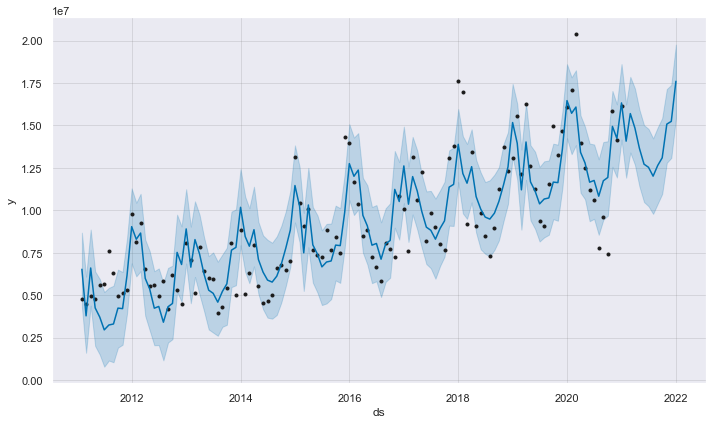

In [238]:
error = mean_absolute_percentage_error(df_prophet_month[-predictions:]['y'], forecast[-predictions:]['yhat'])
print("Mean absolute percentage error {0:.2f}%".format(error))
_ = model.plot(forecast)

При использовании Prophet получаем ошибку в 25.47%

Попробуем применить SARIMA(X)

In [241]:
Ntest = 365
train = df_days.drop('MW_30', axis=1).iloc[:-Ntest]
test = df_days.drop('MW_30', axis=1).iloc[-Ntest:]

train_idx = df.index <= train.index[-1]
test_idx = df.index > train.index[-1]

In [ ]:
from pmdarima.arima import auto_arima

model_autoARIMA = auto_arima(df.iloc[train_idx], start_p=0, start_q=0,
     test='adf',       # use adftest to find optimal 'd'
     max_p=7, max_q=3, # maximum p and q
     m=1,              # frequency of series
     d=0,           # let model determine 'd'
     seasonal=True,   # No Seasonality
     start_P=0, 
     D=0, 
     trace=True,
     error_action='ignore',  
     suppress_warnings=True, 
     stepwise=True)
print(model_autoARIMA.summary())
model_autoARIMA.plot_diagnostics(figsize=(15,8))
plt.show()

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=6605025.379, Time=5.03 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=5263305.903, Time=6.29 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=6204857.036, Time=92.00 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=6861594.194, Time=2.88 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=22.93 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=5238167.617, Time=63.45 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=5237110.556, Time=95.60 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=5236866.535, Time=50.31 sec
 ARIMA(3,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=13.46 sec
